In [1]:
import scipy.io
import os
import shutil
try:
    from urllib import urlretrieve # python2
except:
    from urllib.request import urlretrieve # python3
    
import data as data
import numpy as np
import matplotlib.pyplot as plt
import torch as T
import torch
device = T.device("cuda")  # apply to Tensor or Module
import time
from tqdm import tqdm
import pickle
from train_objectives import SAD, SID

In [2]:
with open("../Dimensec-main-conv2d/periya_images.pickle","rb") as f:
    crop_images=pickle.load(f)
crop_images = torch.tensor(crop_images,dtype=T.float32)
crop_images.to(device)
one_image=crop_images[0]
one_image=one_image[0:268,:,:]

In [3]:
class Net(T.nn.Module):
  def __init__(self):
    super(Net, self).__init__()
    self.enc1 = T.nn.Conv2d(268, 350, 3)  # 64-16-2-16-64
    self.enc2 = T.nn.Conv2d(350, 420, 3)
    
    self.enc3 = T.nn.Conv2d(420, 540, 3)
    self.enc4 = T.nn.Conv2d(540, 610, 3)
    self.enc5 = T.nn.Conv2d(610, 760, 3)
    self.pool = T.nn.MaxPool2d(2,stride=2,return_indices=True)
    self.unpool=T.nn.MaxUnpool2d(2,stride=2,padding=0)
    self.dec4 = T.nn.ConvTranspose2d(760, 610, 3)
    self.dec5 = T.nn.ConvTranspose2d(610, 540, 3)
    self.dec6 = T.nn.ConvTranspose2d(540, 420, 3)
    self.dec7 = T.nn.ConvTranspose2d(420, 350, 3)
    self.dec8 = T.nn.ConvTranspose2d(350, 268, 3)

  def encode(self, x):
    z = T.relu(self.enc1(x))
    z,indeces1=self.pool(z)
    z = T.relu(self.enc2(z))
    size1=z.size()
    z,indeces2=self.pool(z)
    z = T.relu(self.enc3(z))
    size2=z.size()
    z,indeces3=self.pool(z)
    z = T.relu(self.enc4(z))
    size3=z.size()
    z,indeces4=self.pool(z)
    z = T.relu(self.enc5(z))
    size4=z.size()
    z,indeces5=self.pool(z)

    return z.to(device),indeces1,indeces2,size1,indeces3,size2,indeces4,size3,indeces5,size4

  def decode(self, x,indeces1,indeces2,size1,indeces3,size2,indeces4,size3,indeces5,size4):
    
    z=self.unpool(x,indeces5,output_size=size4)
    z = self.dec4(z)
    z=self.unpool(z,indeces4,output_size=size3)
    z = self.dec5(z)
    z=self.unpool(z,indeces3,output_size=size2)
    z = self.dec6(z)
    z=self.unpool(z,indeces2,output_size=size1)
    z = self.dec7(z)
    z=self.unpool(z,indeces1)
    z = self.dec8(z)
    return z   

  def forward(self, x):
    
    z,indeces1,indeces2,size1,indeces3,size2,indeces4,size3,indeces5,size4= self.encode(x)
    z = self.decode(z,indeces1,indeces2,size1,indeces3,size2,indeces4,size3,indeces5,size4)
    return z
net=Net().to(device)

In [4]:
bat_size=10
final=one_image.unsqueeze(0).repeat(bat_size,1,1,1)
final.shape

torch.Size([10, 268, 164, 164])

In [6]:
loss_func1 = T.nn.MSELoss()
loss_func = SAD(268)
lrn_rate = 0.0001

max_epochs=1000
optimizer = T.optim.Adam(net.parameters(), lr=lrn_rate)
train_ldr=[i for i in range(bat_size)]
print("\nbat_size = %3d " % bat_size)
print("loss = " + str(loss_func))
print("optimizer = Adam")
print("max_epochs = %3d " % max_epochs)
print("lrn_rate = %0.3f " % lrn_rate)

print("\nStarting training")
net = net.train()


for epoch in range(0, max_epochs):
  loop= tqdm(enumerate(train_ldr), total=len(train_ldr),leave=True)
  epoch_loss = 0  # for one full epoch
  mseloss=0
  for (batch_idx, batch) in loop:
    X = final.to(device)  # no targets needed

    optimizer.zero_grad()
    oupt = net(X)
    loss_obj = loss_func(oupt, X)  # note: X not Y
    loss_obj1=loss_func1(oupt,X)
    sum_loss=torch.sum(loss_obj.squeeze(1))
    epoch_loss += sum_loss.item()  # accumulate
    mseloss+=loss_obj1.item()
    sum_val=sum_loss+loss_obj1
    sum_val.backward()
    optimizer.step()

    loop.set_description(f"Epoch [{epoch}/{max_epochs}]")
    loop.set_postfix(loss=str(epoch_loss),mseloss=str(mseloss))
"""
  if epoch % ep_log_interval == 0:
    print("epoch = %4d   loss = %0.4f" % (epoch, epoch_loss)) 
print("Done ")"""

# 4. plot digits using reduced form
print("\nCreating graph from encoded data ")
net = net.eval()


bat_size =  10 
loss = SAD()
optimizer = Adam
max_epochs = 1000 
lrn_rate = 0.000 

Starting training


Epoch [135/1000]: 100%|██████████████| 10/10 [00:04<00:00,  2.38it/s, loss=98744.802734375, mseloss=0.4109658896923065]


Epoch [271/1000]: 100%|████████████| 10/10 [00:04<00:00,  2.38it/s, loss=83728.6083984375, mseloss=0.40543900430202484]


Epoch [407/1000]: 100%|███████████| 10/10 [00:04<00:00,  2.38it/s, loss=77964.64404296875, mseloss=0.39602597057819366]


Epoch [543/1000]: 100%|█████████████| 10/10 [00:04<00:00,  2.38it/s, loss=67616.7998046875, mseloss=0.4020928703248501]


Epoch [679/1000]: 100%|█████████████| 10/10 [00:04<00:00,  2.38it/s, loss=62421.7900390625, mseloss=0.4024852328002453]


Epoch [815/1000]: 100%|████████████| 10/10 [00:04<00:00,  2.38it/s, loss=59351.98193359375, mseloss=0.4025452584028244]


Epoch [951/1000]: 100%|████████████| 10/10 [00:04<00:00,  2.38it/s, loss=56827.7373046875, mseloss=0.40256325528025627]


Epoch [999/1000]: 100%|███████████████| 10/10 [00:04<00:00,  2.38it/s, loss=111140.953125, mseloss=0.36802785098552704]


Creating graph from encoded data 


In [9]:
torch.save(net.state_dict(), 'net_compare_sad.pth')

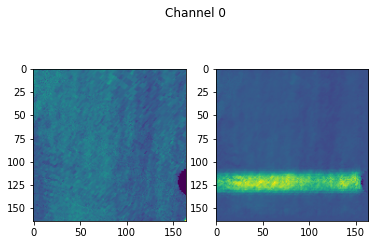

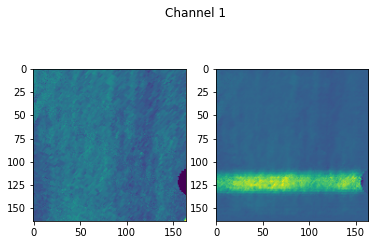

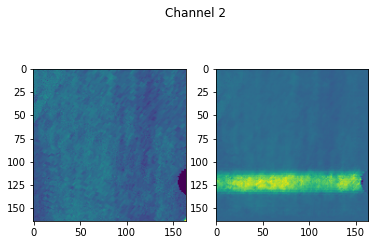

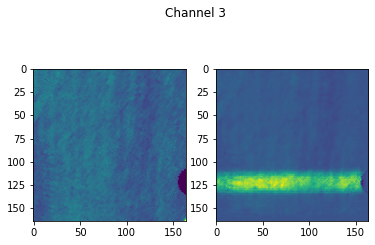

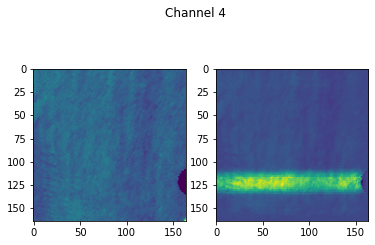

...

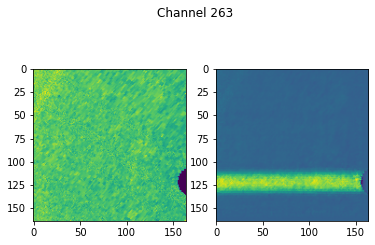

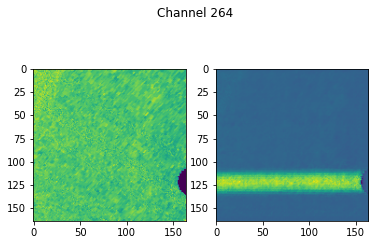

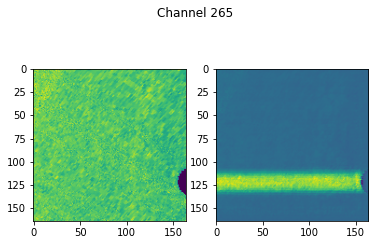

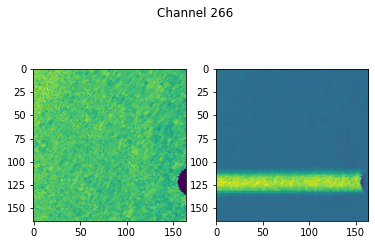

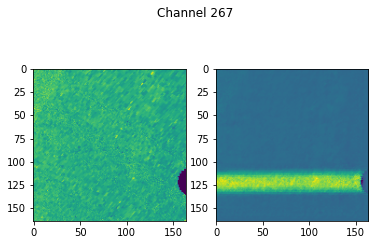

In [8]:

out=net(final[0:1,:,:,:].to("cuda")).to("cpu")
for i in range(268):
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.suptitle('Channel %d'%i)
    ax1.imshow(final[0,i,:,:])
    ax2.imshow(out[0,i,:,:].detach().numpy())
    plt.show()

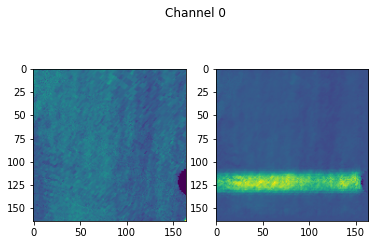

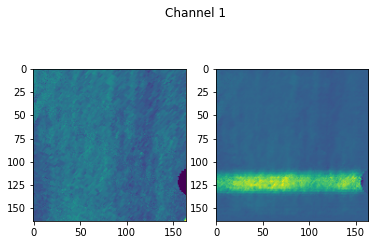

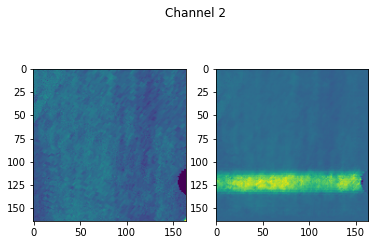

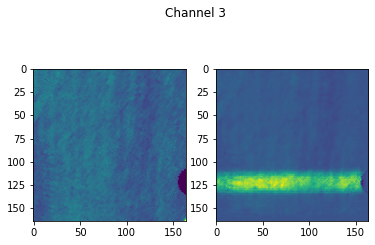

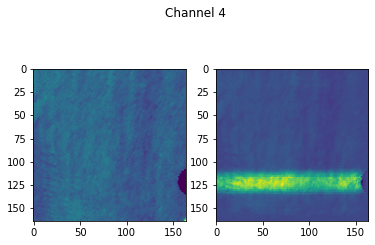

...

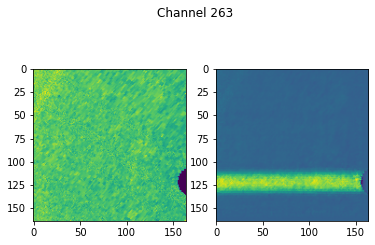

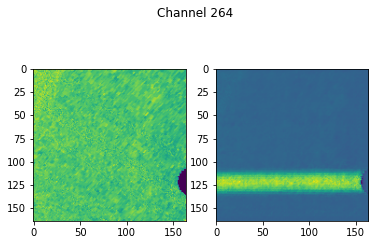

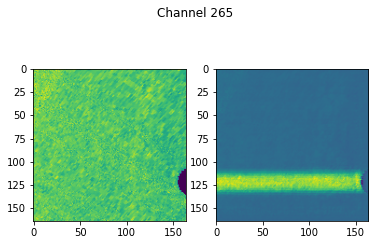

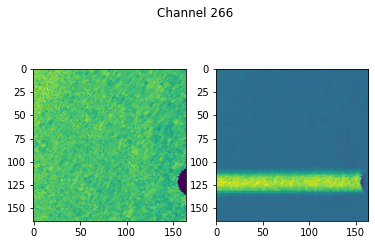

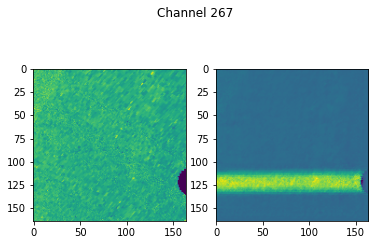

In [10]:
out=net(final[0:1,:,:,:].to("cuda")).to("cpu")
for i in range(268):
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.suptitle('Channel %d'%i)
    ax1.imshow(final[0,i,:,:])
    ax2.imshow(out[0,i,:,:].detach().numpy())
    plt.show()

In [ ]:
out.shape

In [ ]:
plt.imshow(out[0,0,:,:].to("cpu").detach().numpy())